In [1]:
import sys
import os
sys.path.append(os.path.abspath(".."))
from rest.utils import *

import numpy as np
import casadi as ca

### **Problem setup:**

- Task: start from given initial position $p_0$, to reach a given terget position $p_T$ (Stabilization)

- Slope profile (height $h$ with reference to horizontal displacement $p$):  
   - case 1: zero slope (linear case), $h(p) = c$
   - case 2: constant slope (linear case), $h(p) = k \cdot p$
   - case 3: varying slope (nonlinear case), $h(p) = k \cdot cos(\omega p)$
   - case 4: varying slope for under actuated case (nonlinear case), $h(p) = k \cdot sin(\omega p)$

- System dynmaics of 1d mountain car model (in State space representation): 
   - state vector $\bm{x} = [p, v]^T$
   - input vector $u = a$
   - system dynamics:
   \begin{align*}
     \begin{bmatrix} \dot{p} \\ \dot{v} \end{bmatrix} = \begin{bmatrix} v \\ - g \sin(\theta) \cos(\theta) \end{bmatrix} + \begin{bmatrix} 0 \\ \cos(\theta)  \end{bmatrix} a
   \end{align*}

---

### **Part (a): define the mountain car environment and the system dynamics**

In the previous exercise, we demonstrated how to define a symbolic function using CasADi symbolic system, inclusive defining the profile over a slope $h(p)$, deriving the conversion formulas between the slope profile $h(p)$ and the inclination angle $\theta(p)$, and establish the system's dynamics. These formulas have already been integrated into the class `Env` and `Dynamics`. In this chapter, we will specify the arguments and instantiate these classes directly to utilize their functionalities.

**Step 1: specify the arguments for class `Env` and instantiate the class**

- To start with the simpler case (also more compatible with LQR), we will initially focus on a linear system in an unconstrained scenario

- Parameters in the task:  
   - case: 1 / 2 / 3 / 4
   
   - initial state: $\bm{x}_0 = [-1.2, 0.0]^T$
   - target state: $\bm{x}_T = [0.6, 0.0]^T$

**Step 2: call function `test_env()` to plot the mountain profile $h(p)$ and curve of inclination angle $\theta(p)$**

**Step 3: specify the arguments for class `Dynmaics` and instantiate the class**



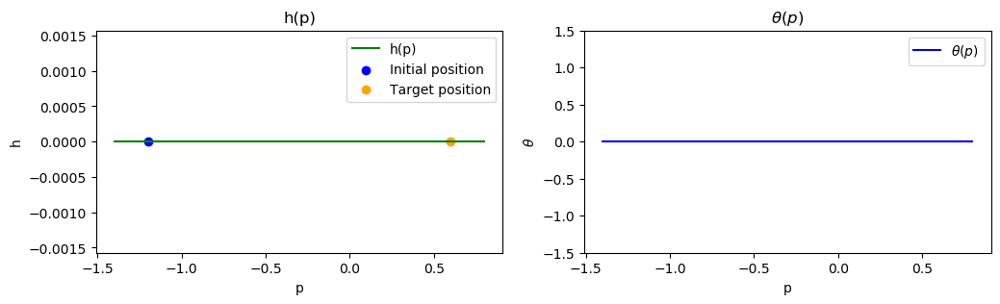

In [2]:
# Define profile of slope, the initial / target state
case = 1 # 1 or 2 or 3 or 4
initial_position = -1.2
initial_velocity = 0.0
target_position = 0.6
target_velocity = 0.0

# Instantiate class 'Env'
# Arguments (without constraints): 
#   1) case: $n \in [1, 2, 3, 4]$, type: int
#   2) initial state: x_0 = [p_0, v_0], type: np.array
#   3) terminal state: x_T = [p_T, v_T], type: np.array
env = Env(case, np.array([initial_position, initial_velocity]), np.array([target_position, target_velocity]))
env.test_env() #  shape of slope (left side) and theta curve (right side) 

# Instantiate class 'Dynamics'
# Arguments: 
#   1) an object of class `Env`, type: Env  
dynamics = Dynamics(env)

---

### **Part (b): Implement the model predictive controller**

In this section, we will provide the implementation of the MPC controller and demonstrate how it can be applied to a stabilization task. We will also visualize the performance of the implemented MPC controller.



**Recall from LQR and iLQR:**

- For linear dynamical systems with a quadratic cost and no constraints, an LQR controller can be designed by solving the Algebraic Riccati Equation (ARE). 

- When the system dynamics are nonlinear and the cost is non-quadratic, the iLQR controller can be used by linearizing the dynamics (first-order Taylor expansion) and approximating the cost (second-order Taylor expansion), though it still cannot handle constraints. 

In this chapter, we introduce the Model Predictive Control (MPC) framework, which approximates the infinite-horizon optimal control problem with a finite and moving horizon formulation, thereby enabling constraint handling. This allows the MPC controller to better adapt to the design of controllers for complex control problems.

**Problem formulation of MPC:**

$$
J_k^*(\boldsymbol{x_k}) = \min_{u_{k|k}, \ldots, u_{k+N-1|k}} 
g_N\left( \boldsymbol{x_{k+N|k}} \right) + \sum_{i=0}^{N-1} g\left( \boldsymbol{x_{k+i|k}}, \boldsymbol{u_{k+i|k}} \right)
$$

subject to:

$$
\boldsymbol{x_{k+i+1|k}} = \boldsymbol{f} \left( \boldsymbol{x_{k+i|k}}, \boldsymbol{u_{k+i|k}} \right), \quad \forall i \in \{0, \ldots, N-1\}
$$

$$
\boldsymbol{x_{k+i|k}} \in \mathcal{X}, \quad \forall i \in \{0, \ldots, N\}
$$

$$
u_{k+i|k} \in \mathcal{U}, \quad \forall i \in \{0, \ldots, N-1\}
$$

$$
\boldsymbol{x_{k+N|k}} \in \mathcal{X}_f, 
$$

$$
\boldsymbol{x_{k|k}} = \boldsymbol{x_{k}},
$$

**Cost design in stabilization task:**

- Stage cost: The cost function consists of a tracking error term and an input penalty term. The tracking error term minimizes the deviation between the state trajectory and the target state, while the input penalty term prevents the controller from applying excessively large (even infinitely large) control inputs in pursuit of rapid convergence.

$$
g\left( \boldsymbol{x_{k+i|k}}, \boldsymbol{u_{k+i|k}} \right) = \left( \boldsymbol{x_{k+i|k}} - \boldsymbol{x_T} \right)^T \boldsymbol{Q} \left( \boldsymbol{x_{k+i|k}} - \boldsymbol{x_T} \right) + u_{k+i|k} ^T \boldsymbol{R} u_{k+i|k}
$$

- Terminal cost: only the tracking error term

$$
g_N\left( \boldsymbol{x_{k+N|k}} \right) = \left( \boldsymbol{x_{k+N|k}} - \boldsymbol{x_T} \right)^T \boldsymbol{Q_f} \left( \boldsymbol{x_{k+N|k}} - \boldsymbol{x_T} \right)
$$


**Step 1: define the setup function for MPC controller**  

In this step, we will implement the setup function `setup_external()`, which will be automatically called in the constructor of class `LQRController`. The implementation will follow three key steps:

1\) Obtain the system matrices: Retrieve the $\bm{A}$ and $\bm{B}$ matrices from the discrete-time system dynamics;  
    Hint: you may use the method `get_linearized_AB_discrete()` from class `Dynamics` to get the discretized system matrices

2\) Solve for the Hessian matrix $\bm{S}$ of optimal cost: Compute the solution to the Discrete Algebraic Riccati Equation (DARE) to obtain $\bm{S}$;  
    Hint: you may use the method `scipy.linalg.solve_discrete_are()` to solve DARE

3\) Calculate the feedback gain $\bm{K}$: Use the computed Hessian $\bm{S}$ to determine the LQR feedback gain $\bm{K}$;  
    Hint: you may use the method `numpy.linalg.inv()` to solve the inverse matrix

In [3]:
def setup_external(self) -> None:

    """
    Define the MPC optimization problem using Acados.
    """

    # Initialize Acados model
    model = AcadosModel()
    model.name = "mpc_controller"

    # Define model: dx/dt = f(x, u)
    model.x = self.dynamics.states
    model.u = self.dynamics.inputs
    model.f_expl_expr = ca.vertcat(self.dynamics.dynamics_function(self.dynamics.states, self.dynamics.inputs))
    model.f_impl_expr = None

    # Set up Acados OCP
    ocp = AcadosOcp()
    ocp.model = model
    ocp.dims.N = self.N  # Prediction horizon
    ocp.solver_options.tf = self.N * self.dt  # Total prediction time
    ocp.solver_options.qp_solver = "PARTIAL_CONDENSING_HPIPM"
    ocp.solver_options.integrator_type = "ERK"
    ocp.solver_options.nlp_solver_type = "SQP"

    # Set up cost function
    ocp.cost.cost_type = "LINEAR_LS"
    ocp.cost.cost_type_e = "LINEAR_LS"
    ocp.cost.W = np.block([
        [self.Q, np.zeros((self.dim_states, self.dim_inputs))],
        [np.zeros((self.dim_inputs, self.dim_states)), self.R],
    ])
    ocp.cost.W_e = self.Qf

    # Set up mapping from QP to OCP
    # Define output matrix for non-terminal state
    ocp.cost.Vx = np.block([
        [np.eye(self.dim_states)],
        [np.zeros((self.dim_inputs, self.dim_states))]
    ])
    # Define breakthrough matrix for non-terminal state
    ocp.cost.Vu = np.block([
        [np.zeros((self.dim_states, self.dim_inputs))],
        [np.eye(self.dim_inputs)]
    ])
    # Define output matrix for terminal state
    ocp.cost.Vx_e = np.eye(self.dim_states)

    # Initialize reference of task (stabilization)
    ocp.cost.yref = np.zeros(self.dim_states + self.dim_inputs) 
    ocp.cost.yref_e = np.zeros(self.dim_states) 

    # Define constraints
    ocp.constraints.x0 = self.init_state  # Initial state
    
    ocp.constraints.idxbx = np.arange(self.dim_states)
    ocp.constraints.idxbx_e = np.arange(self.dim_states)
    if self.env.state_lbs is None and self.env.state_ubs is None:
        ocp.constraints.lbx = np.full(self.dim_states, -1e6)
        ocp.constraints.ubx = np.full(self.dim_states, 1e6)
        ocp.constraints.lbx_e = np.full(self.dim_states, -1e6)
        ocp.constraints.ubx_e = np.full(self.dim_states, 1e6)
    elif self.env.state_lbs is not None and self.env.state_ubs is None:
        ocp.constraints.lbx = np.array(self.env.state_lbs)
        ocp.constraints.ubx = np.full(self.dim_states, 1e6)
        ocp.constraints.lbx_e = np.array(self.env.state_lbs)
        ocp.constraints.ubx_e = np.full(self.dim_states, 1e6)
    elif self.env.state_lbs is None and self.env.state_ubs is not None:
        ocp.constraints.lbx = np.full(self.dim_states, -1e6)
        ocp.constraints.ubx = np.array(self.env.state_ubs)
        ocp.constraints.lbx_e = np.full(self.dim_states, -1e6)
        ocp.constraints.ubx_e = np.array(self.env.state_ubs)
    else:
        ocp.constraints.lbx = np.array(self.env.state_lbs)
        ocp.constraints.ubx = np.array(self.env.state_ubs)
        ocp.constraints.lbx_e = np.array(self.env.state_lbs)
        ocp.constraints.ubx_e = np.array(self.env.state_ubs)
    
    ocp.constraints.idxbu = np.arange(self.dim_inputs)
    if self.env.input_lbs is None and self.env.input_ubs is None:
        ocp.constraints.lbu = np.full(self.dim_inputs, -1e6)
        ocp.constraints.ubu = np.full(self.dim_inputs, 1e6)
    elif self.env.input_lbs is not None and self.env.input_ubs is None:
        ocp.constraints.lbu = np.array(self.env.input_lbs)
        ocp.constraints.ubu = np.full(self.dim_inputs, 1e6)
    elif self.env.input_lbs is None and self.env.input_ubs is not None:
        ocp.constraints.lbu = np.full(self.dim_inputs, -1e6)
        ocp.constraints.ubu = np.array(self.env.input_ubs)
    else:
        ocp.constraints.lbu = np.array(self.env.input_lbs)
        ocp.constraints.ubu = np.array(self.env.input_ubs)

    # Set up Acados solver
    self.ocp = ocp
    self.solver = AcadosOcpSolver(ocp, json_file=f"{model.name}.json")

    if self.verbose:
        print("MPC setup with Acados completed.")


**Step 2: define the loop function to call the API of Acados in each control cycle**  

In this step, we will implement the setup function `setup_external()`, which will be automatically called in the constructor of class `LQRController`. The implementation will follow three key steps:

1\) Obtain the system matrices: Retrieve the $\bm{A}$ and $\bm{B}$ matrices from the discrete-time system dynamics;  
    Hint: you may use the method `get_linearized_AB_discrete()` from class `Dynamics` to get the discretized system matrices

2\) Solve for the Hessian matrix $\bm{S}$ of optimal cost: Compute the solution to the Discrete Algebraic Riccati Equation (DARE) to obtain $\bm{S}$;  
    Hint: you may use the method `scipy.linalg.solve_discrete_are()` to solve DARE

3\) Calculate the feedback gain $\bm{K}$: Use the computed Hessian $\bm{S}$ to determine the LQR feedback gain $\bm{K}$;  
    Hint: you may use the method `numpy.linalg.inv()` to solve the inverse matrix

In [ ]:
def compute_action_external(self, current_state: np.ndarray, current_time) -> np.ndarray:
    """
    Solve the MPC problem and compute the optimal control action.

    Args:
    - current_state: The current state of the system.
    - current_time: The current time (not directly used).

    Returns:
    - Optimal control action.
    """
    # Update initial state in the solver
    self.solver.set(0, "lbx", current_state)
    self.solver.set(0, "ubx", current_state)

    # Update reference trajectory for all prediction steps
    state_ref = self.target_state
    input_ref = np.zeros(self.dim_inputs)
    for i in range(self.N):
        self.solver.set(i, "yref", np.concatenate((state_ref, input_ref)))
    self.solver.set(self.N, "yref", state_ref) # set reference valur for y_N seperately (different shape)

    # Solve the MPC problem
    status = self.solver.solve()
    if status != 0:
        raise ValueError(f"Acados solver failed with status {status}")

    # Extract the first control action
    u_optimal = self.solver.get(0, "u")

    if self.verbose:
        print(f"Optimal control action: {u_optimal}")

    return u_optimal

**Step 3: Bind the defined setup function to the class "LQRController", and run the simulation to see the performance of controller**  

1\) Bind the defined setup function for DP algorithm `setup_external()` to class `LQRController`;

2\) Specify the arguments and instantiate the controller class `LQRController` as `LQR_0`; 

- Parameters in the task:  

    i) weight for state $\bm{Q} = \text{diag}([1, 1])$ (requirement: symmetric, positive semi-definite matrix)  

    ii) weight for input $\bm{R} = [1]$ (requirement: symmetric, positive definite matrix)  
    
    iii) control frequency $f = 20$

3\) Instantiate the class `Simulator` and call function `run_simulation()` to generate the simulated state- and input-trajectory;

4\) Instantiate the class `Visualizor`, call function `display_final_results()` and `display_animation()` to show the simulations;


Check passed, Q is a symmetric, positive semi-definite matrix.
Check passed, R is a symmetric, positive definite matrix.
Check passed, current gain K=[[0.95762716 1.68294507]], close-loop system is stable.
Simulation finished, will start plotting


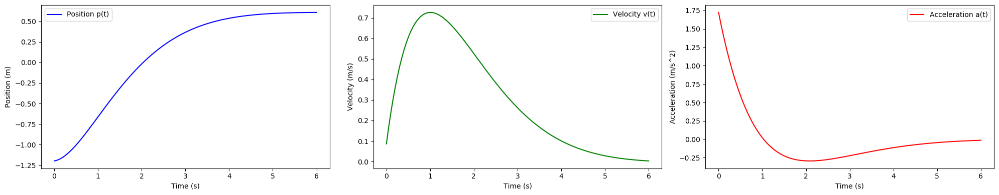

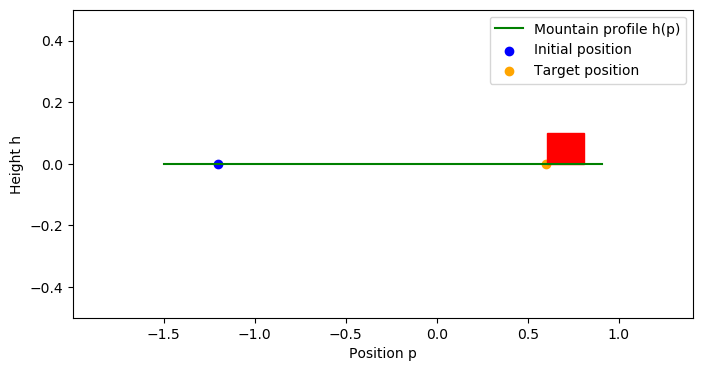

In [4]:
# Bind the defined MPC controller setup function to the corresponding class, will be automatically called by constructor
MPCController.setup = setup_external
MPCController.compute_action = compute_action_external

# Define weight matrix in stage and terminal cost
Q_0 = np.diag([1, 1])
R = np.array([[1]])

# Define parameters of simulation
freq = 20 # controll frequency
t_terminal = 6 # time length of simulation

# Instantiate the LQR controller class
# Arguments: 
#   1) an object of class `Env` (to deliver infos about initial state, constraints, etc.), type: Env  
#   2) an object of class `Dynamics` (to deliver infos about symbolic system dynamics), type: Dynamics  
#   3) weight matrices in cost functions: i) `Q`: weight metrix of state, type: np.array  
#                                         ii) `R`: weight metrix of input, type: np.array  
#   4) freq: control frequency $f$ , type: int  
#   5) name: the name of current coltroller displayed in plots, type: string
controller_lqr_0 = LQRController(env, dynamics, Q_0, R, freq, name='LQR_0')

# Instantiate the simulator, and then run the simulation
simulator_lqr_0 = Simulator(dynamics, controller_lqr_0, env, 1/freq, t_terminal)
simulator_lqr_0.run_simulation()

# Instantiate the visualizer, and display the plottings and animation
visualizer_lqr_0 = Visualizer(simulator_lqr_0)
visualizer_lqr_0.display_plots()
visualizer_lqr_0.display_animation()


---

### **Part (C): Influence of the Weight Matrix on LQR Performance**

In this section, we will analyze how the choice of weight matrices in the cost function affects the performance of the LQR controller. By tuning the weight matrices $\bm{Q}$ (which penalize deviations in state) while keeping $\bm{R}$ (which penalizes control input) fixed, we can observe how the system behaves under different control strategies.

Specifically, we define two LQR controller with different weight matrices: 

- `LQR_1`: $ \quad \bm{Q}_1 = \text{diag}([10, 10]), \quad \bm{R} = [1]$  

- `LQR_2`: $ \quad \bm{Q}_2 = \text{diag}([0.2, 0.2]), \quad \bm{R} = [1]$  

Using these configurations, we simulate the system's response under two LQR controllers (`LQR_1` and `LQR_2`) and and make a contrast with the controller defined in the last step (`LQR_0`). By observing the results, we gain insight into how adjusting the weight matrix influences the controller's aggressiveness and efficiency.

Check passed, Q is a symmetric, positive semi-definite matrix.
Check passed, R is a symmetric, positive definite matrix.
Check passed, current gain K=[[2.85872132 3.72689284]], close-loop system is stable.
Simulation finished, will start plotting
Check passed, Q is a symmetric, positive semi-definite matrix.
Check passed, R is a symmetric, positive definite matrix.
Check passed, current gain K=[[0.43566928 1.03011955]], close-loop system is stable.
Simulation finished, will start plotting


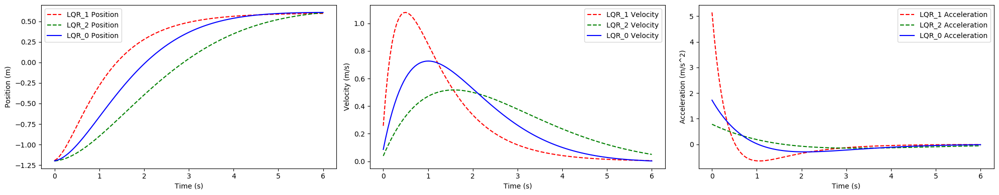

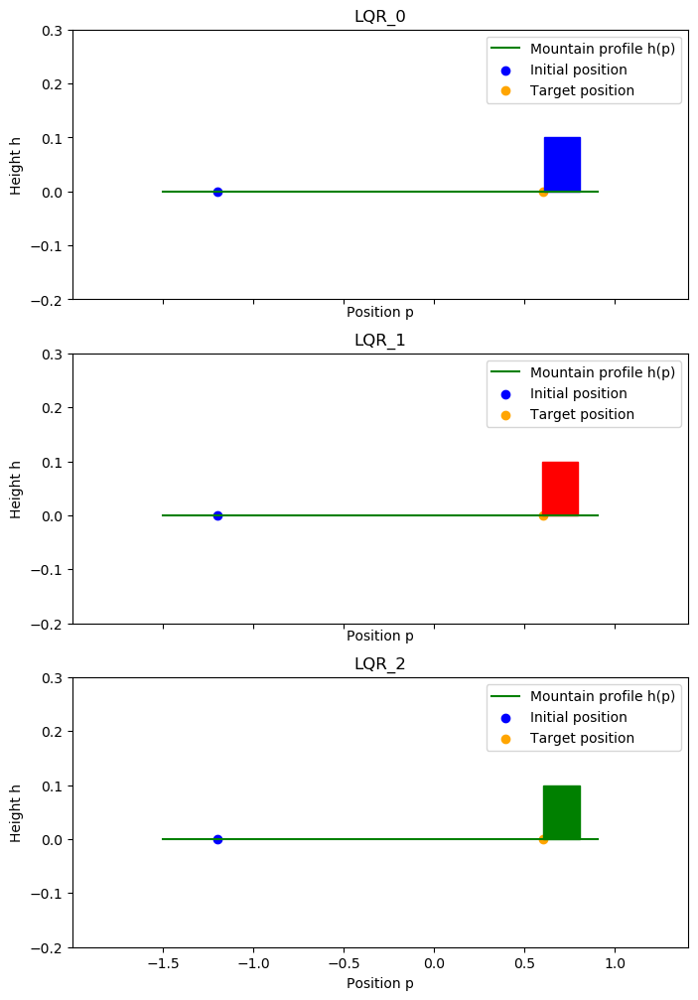

In [5]:
# Define weight matrix in stage and terminal cost
#   for reference: Q_0 = np.diag([1, 1])
Q_1 = np.diag([10, 10])
Q_2 = np.diag([0.2, 0.2])

# Instantiate the LQR controller class, the simulator class, and then run the simulation
controller_lqr_1 = LQRController(env, dynamics, Q_1, R, freq, name='LQR_1')
simulator_lqr_1 = Simulator(dynamics, controller_lqr_1, env, 1/freq, t_terminal)
simulator_lqr_1.run_simulation()

controller_lqr_2 = LQRController(env, dynamics, Q_2, R, freq, name='LQR_2')
simulator_lqr_2 = Simulator(dynamics, controller_lqr_2, env, 1/freq, t_terminal)
simulator_lqr_2.run_simulation()

# Instantiate the visualizer, and display the plottings and animation
visualizer_lqr_0.display_contrast_plots(simulator_lqr_1, simulator_lqr_2)
visualizer_lqr_0.display_contrast_animation(simulator_lqr_1, simulator_lqr_2)

#### **Results Analysis: Influence of LQR Weight Matrices on System Performance**

The figure above compares the performance of three Linear Quadratic Regulator (LQR) controllers: **LQR_1**, **LQR_2**, and **LQR_0**. Each controller is defined with different weight matrices $\bm{Q}$, which penalize the state deviations, while $\bm{R}$, which penalizes control effort, remains the same.

The comparison clearly demonstrates the impact of the weight matrix $\bm{Q}$ on LQR performance:
1. **Higher $\bm{Q}$** (LQR_1):  
   - Prioritizes minimizing state deviations.  
   - Results in faster convergence but higher control effort.  

2. **Lower $\bm{Q}$** (LQR_2):  
   - Reduces control effort and produces smoother trajectories.  
   - Leads to slower convergence and delayed state correction.  

3. **Moderate $\bm{Q}$** (LQR_0):  
   - Balances control effort and tracking performance.  

The selection of $\bm{Q}$ depends on the system's requirements:  
- For tasks requiring fast convergence, a higher $\bm{Q}$ is appropriate.  
- For energy-constrained systems, a lower $\bm{Q}$ ensures smoother and less aggressive control. 

#### **Main Conclusion:**

By tuning the relative magnitude of weight matrices $\bm{Q}$ and $\bm{R}$, LQR controllers can achieve the desired trade-off between tracking performance and control effort.

*Note 1: Here we have only discussed the effect of $\bm{Q}$. The effect of $\bm{R}$ is inverse, as the controller's behavior is fundamentally influenced by the relative magnitude of $\bm{Q}$ and $\bm{R}$.*

*Note 2: In this example, we use $\bm{Q}$ with eigenvalues equal to $\bm{R}$ as a moderate baseline. However, this choice does not universally apply, as the magnitude of states and inputs depends on their units. But conversely, in the practice it is always important to carefully scale the states and inputs to similar numerical ranges. Otherwise, large discrepancies in the scales of $\bm{Q}$ and $\bm{R}$ can result in an ill-conditioned cost Hessian, causing numerical instability and divergence during optimization.*

---


### **Part (D): Limitations of the LQR Controller**

At last, we want to emphasize the limitations of LQR: 

  1) a **linear dynamics**;  

  2) a **quadratic cost function**;  
  
  3) and operates under **no constraints**;  

While the quadratic cost is well-suited for these assumptions, we will mostly focus on the last 2 requirements.


#### **1. Linear vs. Nonlinear Dynamics**

LQR is designed specifically for **linear systems**, where its optimality is well established. However, in real-world applications, most systems exhibit **nonlinear dynamics**. Directly applying LQR to nonlinear systems can lead to degraded control performance, reduced accuracy, and potential instability. 

In this section, we will explore this limitation through a comparative study. We design two test cases:  

 - `LQR_0`: Using a purely linear system for the dynamics (from case 1 or 2)

 - `LQR_disturbance`: Using a nonlinear system dynamics (from case 3 or 4)

while keeping the same task definitions and cost design as in the linear case. By analyzing the results, we aim to understand how nonlinearity impacts the effectiveness of the LQR controller under identical conditions.  


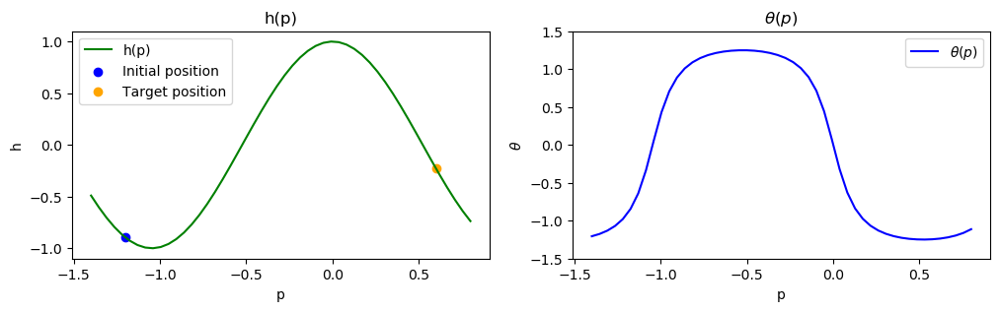

Check passed, Q is a symmetric, positive semi-definite matrix.
Check passed, R is a symmetric, positive definite matrix.
Check passed, current gain K=[[0.95762716 1.68294507]], close-loop system is stable.
Simulation finished, will start plotting


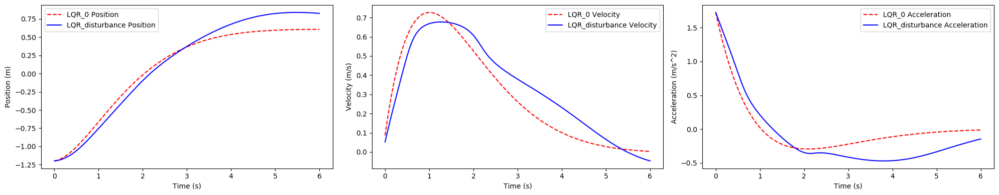

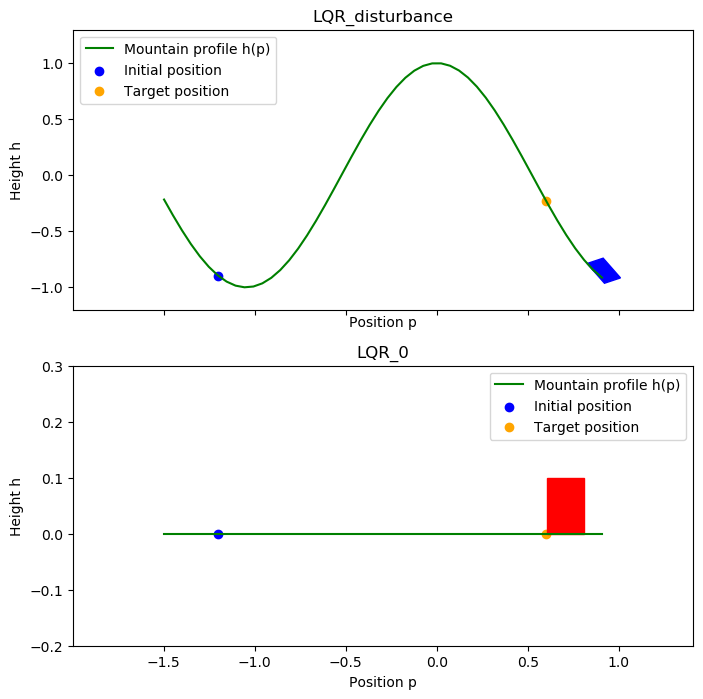

In [6]:
# Define the case
case_disturbance = 3 # 3 or 4

# Instantiate class 'Env' and visualize the shape of the slope (left side) and theta curve (right side) 
env_disturbance = Env(case_disturbance, np.array([initial_position, initial_velocity]), np.array([target_position, target_velocity]))
env_disturbance.test_env()

# Instantiate class 'Dynamics'
dynamics_disturbance = Dynamics(env_disturbance)

# Instantiate the LQR controller class
controller_lqr_disturbance = LQRController(env_disturbance, dynamics_disturbance, Q_0, R, freq, name='LQR_disturbance')

# Instantiate the simulator, and then run the simulation
simulator_lqr_disturbance = Simulator(dynamics_disturbance, controller_lqr_disturbance, env_disturbance, 1/freq, t_terminal)
simulator_lqr_disturbance.run_simulation()

# Instantiate the visualizer, and display the plottings and animation
visualizer_lqr_disturbance = Visualizer(simulator_lqr_disturbance)
visualizer_lqr_disturbance.display_contrast_plots(simulator_lqr_0)
visualizer_lqr_disturbance.display_contrast_animation(simulator_lqr_0)


#### **Results Analysis: Influence of LQR on Nonlinear Dynamics**

From the results shown in the figure, a significant difference can be observed when applying the LQR control law to a system with nonlinear dynamics versus a linear system:  

- **Nonlinear Dynamics** (`LQR_disturbance`): The system fails to directly stabilize at the target position. Instead, the trajectory exhibits overshoot before gradually returning to the desired state. This behavior arises because the LQR control law, designed for linear systems, cannot fully compensate for the nonlinearities in the dynamics.  

- **Linear Dynamics** (`LQR_0`): The system stabilizes precisely at the target position without overshoot, demonstrating the optimality and precision of LQR under its intended linear assumptions.  

#### **Main Conclusion:**
While sometimes the controller can still stabilize the system, the presence of overshoot and deviations highlights its suboptimal performance when linear assumptions are violated.

*Note: The loss of accuracy in nonlinear systems can be mitigated by applying the **iterative LQR (iLQR)** method (which will be introduced in the next Lecture). The key idea of iLQR is to perform a Taylor expansion of the cost function and dynamics around each operating point, incorporating higher-order derivatives into the optimization process. In fact, LQR can be viewed as a special case of iLQR when the system dynamics are linear.*

---


#### **2. Effect of Input Constraints on LQR Performance**

LQR is formulated under the assumption of **unconstrained inputs**, meaning it does not inherently support input saturation or upper/lower constraints. However, in real-world systems, control inputs such as force, torque, or voltage often have physical limits. When the LQR controller generates control inputs exceeding these limits, the inputs will be **clipped** to the boundaries. This behavior can cause saturation between the actual system trajectory and the ideal trajectory predicted by the LQR controller.

To illustrate this limitation, we design two test scenarios:

- **Ideal LQR Control (`LQR_0`)**:  

   - No constraints are applied to the control inputs

   - The system follows the ideal trajectory predicted by the LQR controller

- **Clipped LQR Control (`LQR_real_traj`)**: 

   - Input constraints are imposed, where the acceleration is limited within an upper and lower bound

   - Any control input exceeding these bounds is **clipped**, leading to saturation

Check passed, Q is a symmetric, positive semi-definite matrix.
Check passed, R is a symmetric, positive definite matrix.
Check passed, current gain K=[[0.95762716 1.68294507]], close-loop system is stable.
Simulation finished, will start plotting


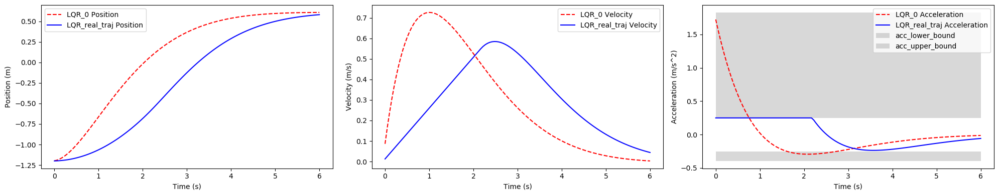

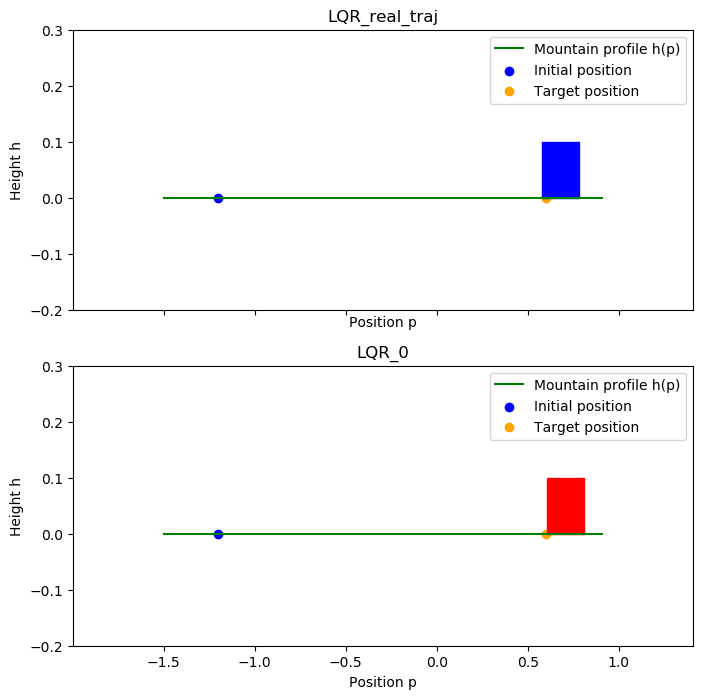

In [7]:
# Define a upper bound of input a
input_ubs = 0.25
input_lbs = -0.25

# Instantiate class 'Env' and visualize the shape of the slope (left side) and theta curve (right side) 
# Arguments (with state / input constraint): 
#   1) case: $n \in [1, 2, 3, 4]$, type: int
#   2) initial state: x_0 = [p_0, v_0], type: np.array
#   3) terminal state: x_T = [p_T, v_T], type: np.array
#   4) constraints on states: i) lbx [\underline{p}, \underline{v}], type: np.array or None
#                             ii) ubx [\overline{p}, \overline{v}], type: np.array or None
#   5) constraints on input: i) lbu \underline{u}, type: float or None
#                            ii) ubu \overline{u}, type: float or None
env_input_constraint = Env(case, np.array([initial_position, initial_velocity]), np.array([target_position, target_velocity]), 
                           input_lbs=input_lbs, input_ubs=input_ubs)

# Instantiate the LQR controller class
controller_lqr_input_constraint = LQRController(env_input_constraint, dynamics, Q_0, R, freq, name='LQR_real_traj')

# Instantiate the simulator, and then run the simulation
simulator_lqr_input_constraint = Simulator(dynamics, controller_lqr_input_constraint, env_input_constraint, 1/freq, t_terminal)
simulator_lqr_input_constraint.run_simulation()

# Instantiate the visualizer, and display the plottings and animation
visualizer_lqr_input_constraint = Visualizer(simulator_lqr_input_constraint)
visualizer_lqr_input_constraint.display_contrast_plots(simulator_lqr_0)
visualizer_lqr_input_constraint.display_contrast_animation(simulator_lqr_0)




#### **Results Analysis**

1. **Acceleration Response**:  
   - In the acceleration plot (right panel), the ideal LQR (red dashed line) generates a continuous and unconstrained input.  
   - However, the constrained LQR (blue solid line) shows clear cut-off behavior, where the input is clipped to the specified upper and lower bounds (gray shaded regions). This results in a flattened profile that deviates from the ideal input.

2. **Position Response**:  
   - In the position plot (left panel), the ideal trajectory (LQR_0, red dashed line) smoothly reaches the target position.  
   - In contrast, the constrained trajectory (LQR_real_traj, blue solid line) shows slower convergence due to input clipping, resulting in noticeable deviations from the ideal trajectory.

This limitation highlights the importance of considering input constraints during controller design. Methods such as **constrained optimal control** or **Model Predictive Control (MPC)** can address this issue by explicitly incorporating input limits into the optimization problem.